In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
import time

from IPython.display import clear_output


# check if/whar is still needed.
from utils import get_views_coord
from utils import test_val_train
from utils import get_spatial_hps


#from utils import sample_conflict_timeline
#from utils import get_hyper_priors
#from utils import predict
#from utils import plot_predictions
#from utils import get_mse
#from utils import get_metrics

import pymc3 as pm
import theano
import theano.tensor as tt

import warnings
warnings.simplefilter("ignore", UserWarning)

In [2]:
def get_spatial_mp(month_id, nnz, η_beta, ℓ_beta, ℓ_alpha, σ_beta):
    
    try:

        with pm.Model() as model:

            # trend
            ℓ = pm.Gamma("ℓ", alpha=ℓ_alpha , beta=ℓ_beta)
            η = pm.HalfCauchy("η", beta=η_beta)
            cov = η **2 * pm.gp.cov.ExpQuad(2, ℓ) # Cov func.

            # noise model
            σ = pm.HalfCauchy("σ", beta=σ_beta)

            # mean func. (constant) 
            mean =  pm.gp.mean.Zero()

            # gp = pm.gp.Marginal(mean_func = mean, cov_func=cov)
            #gp = pm.gp.MarginalSparse(mean_func = mean, cov_func=cov)

            # sample and split X,y ---------------------------------------------  
            non_zeroes = df.groupby('pg_id').sum().sort_values('ged_best_sb', ascending = False).index[:nnz]

            y = np.log(df[(df['id'].isin(train_id)) & (df['month_id'] == month_id)]['ged_best_sb'].values + 1)
            X = df[(df['id'].isin(train_id))  & (df['month_id'] == month_id)][['xcoord','ycoord']].values
            Xu = df[(df['id'].isin(train_id)) & (df['pg_id'].isin(non_zeroes)) & (df['month_id'] == month_id)][['xcoord','ycoord']].values

            # The GP
            gp = pm.gp.MarginalSparse(cov_func=cov) #, approx="DTC") # ved ikke om det gør en forskel til FICT
            y_ = gp.marginal_likelihood("y", X=X, Xu = Xu, y=y, noise= σ)

            #gp = pm.gp.Marginal(cov_func=cov) 
            #y_ = gp.marginal_likelihood("y_", X=X, y=y, noise= σ)
            mp = pm.find_MAP()

            return(mp)
    
    except:
        pass

In [2]:
# get df:
path = '/home/simon/Documents/Articles/conflict_prediction/data/ViEWS/'
file_name = 'ViEWS_coord.pkl'
df = get_views_coord(path = path, file_name = file_name)
print('got df')

# get trian/test id
train_id, val_id = test_val_train(df)
print('got split')


got df
Train from 1/1990 trough 12/2011 (264)
Val from 1/2012 trough 12/2014 (36)
Test time from 1/2015 trough 12/2017 (36)
(Test=False, so test set not outputted)

got split


In [4]:
#month_id = 384 # last month in train doing val
η_beta, ℓ_beta, ℓ_alpha, σ_beta = get_spatial_hps(plot = False)
nnz = 100
month_ids = df[df['id'].isin(train_id)]['month_id'].unique()
n = len(month_ids)

ℓ_list = []
η_list = []
σ_list = []

for i, j in enumerate(month_ids[:3]):
    
    print(f'{i}/{n}')
    mp = get_spatial_mp(j, nnz, η_beta, ℓ_beta, ℓ_alpha, σ_beta)

    if mp != None:
    
        ℓ_list.append(mp['ℓ'])
        η_list.append(mp['η'])
        σ_list.append(mp['σ'])
    
    else:
        pass
    
    clear_output(wait=True)

2/264


In [5]:
mp = {'ℓ_log__': np.log(np.mean(ℓ_list)),
 'η_log__': np.log(np.mean(η_list)),
 'σ_log__': np.log(np.mean(σ_list)),
 'ℓ': np.mean(ℓ_list),
 'η': np.mean(η_list),
 'σ': np.mean(σ_list)}

In [6]:
mp

{'ℓ_log__': 0.49542651289272754,
 'η_log__': -3.1432348615319623,
 'σ_log__': -1.764599875920002,
 'ℓ': 1.641198081941896,
 'η': 0.04314301026276412,
 'σ': 0.1712552961456595}

In [ ]:
# new_file_name = '/home/projects/ku_00017/data/generated/currents/sce_mp_dict.pkl'
# output = open(new_file_name, 'wb')
# pickle.dump(out_dict, output)
# output.close()

# # end timer
# final_time = time.time()
# final_run_time = final_time - start_time
# string = f'Run for {final_run_time/60:.3} minutes'
# print(string)

In [15]:
        month_id = 384 # last month in train doing val
        nnz = 100
        with pm.Model() as model:

            # trend
            ℓ = pm.Gamma("ℓ", alpha=ℓ_alpha , beta=ℓ_beta)
            η = pm.HalfCauchy("η", beta=η_beta)
            cov = η **2 * pm.gp.cov.ExpQuad(2, ℓ) # Cov func.

            # noise model
            σ = pm.HalfCauchy("σ", beta=σ_beta)

            # mean func. (constant) 
            mean =  pm.gp.mean.Zero()

            # gp = pm.gp.Marginal(mean_func = mean, cov_func=cov)
            #gp = pm.gp.MarginalSparse(mean_func = mean, cov_func=cov)

            # sample and split X,y ---------------------------------------------  
            non_zeroes = df.groupby('pg_id').sum().sort_values('ged_best_sb', ascending = False).index[:nnz]

            y = np.log(df[(df['id'].isin(train_id)) & (df['month_id'] == month_id)]['ged_best_sb'].values + 1)
            X = df[(df['id'].isin(train_id))  & (df['month_id'] == month_id)][['xcoord','ycoord']].values
            Xu = df[(df['id'].isin(train_id)) & (df['pg_id'].isin(non_zeroes)) & (df['month_id'] == month_id)][['xcoord','ycoord']].values

            # The GP
            gp = pm.gp.MarginalSparse(cov_func=cov) #, approx="DTC") # ved ikke om det gør en forskel til FICT
            y_ = gp.marginal_likelihood("y", X=X, Xu = Xu, y=y, noise= σ)

In [16]:
mu, var = gp.predict(X, point=mp, given = {'gp' : gp, 'X' : X, 'y' : y, 'noise' : σ }, diag=True)

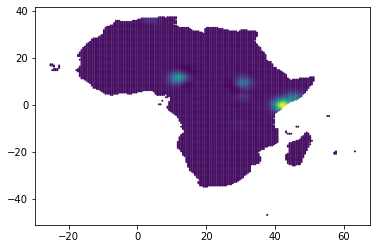

In [17]:
plt.scatter(X[:,0], X[:,1], c = mu, s = 1)
plt.show()

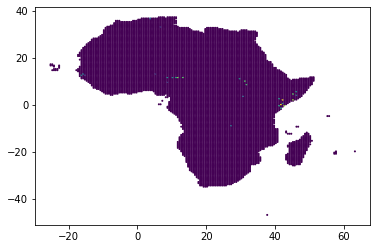

In [9]:
plt.scatter(X[:,0], X[:,1], c = y, s = 1)
plt.show()

In [19]:
gmp = {'ℓ_log__': np.array(0.20046489),
 'η_log__': np.array(-2.77767888),
 'σ_log__': np.array(-1.72180393),
 'ℓ': np.array(1.22197071),
 'η': np.array(0.06218267),
 'σ': np.array(0.17874342)}

In [20]:
mu, var = gp.predict(X, point=gmp, given = {'gp' : gp, 'X' : X, 'y' : y, 'noise' : σ }, diag=True)

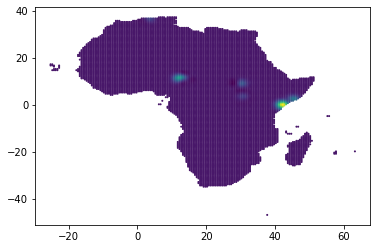

In [21]:
plt.scatter(X[:,0], X[:,1], c = mu, s = 1)
plt.show()

# Group all

In [10]:
df_mean = df.groupby(['pg_id', 'xcoord', 'ycoord']).mean()[['ged_best_sb']].reset_index()
df_mean['log_best_sb'] = np.log(df_mean['ged_best_sb'] + 1)

non_zeroes = df_mean[df_mean['log_best_sb'] > 1]['pg_id'].values
print(non_zeroes.shape)

with pm.Model() as model:

    # trend
    ℓ = pm.Gamma("ℓ", alpha=ℓ_alpha , beta=ℓ_beta)
    η = pm.HalfCauchy("η", beta=η_beta)
    cov = η **2 * pm.gp.cov.ExpQuad(2, ℓ) # Cov func.

    # noise model
    σ = pm.HalfCauchy("σ", beta=σ_beta)

    # mean func. (constant) 
    mean =  pm.gp.mean.Zero()

    # gp = pm.gp.Marginal(mean_func = mean, cov_func=cov)
    #gp = pm.gp.MarginalSparse(mean_func = mean, cov_func=cov)
    
    # sample and split X,y ---------------------------------------------  
    # non_zeroes = df_mean.groupby('pg_id').sum().sort_values('ged_best_sb', ascending = False).index[:nnz]


    y = df_mean['log_best_sb'].values
    X = df_mean[['xcoord','ycoord']].values
    Xu = df_mean[df['pg_id'].isin(non_zeroes)][['xcoord','ycoord']].values

    # The GP
    gp = pm.gp.MarginalSparse(cov_func=cov) # ved ikke om det gør en forskel til FICT
    y_ = gp.marginal_likelihood("y", X=X, Xu =Xu, y=y, noise= σ)
    
    #gp = pm.gp.Marginal(cov_func=cov) 
    #y_ = gp.marginal_likelihood("y_", X=X, y=y, noise= σ)
    mp = pm.find_MAP()


(101,)


In [11]:
mp

{'ℓ_log__': array(0.20046489),
 'η_log__': array(-2.77767888),
 'σ_log__': array(-1.72180393),
 'ℓ': array(1.22197071),
 'η': array(0.06218267),
 'σ': array(0.17874342)}

In [12]:
mu, var = gp.predict(X, point=mp, given = {'gp' : gp, 'X' : X, 'y' : y, 'noise' : σ }, diag=True)

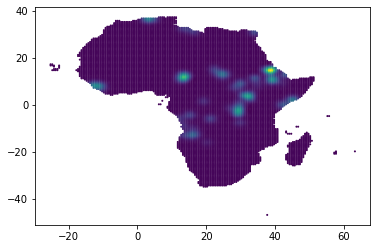

In [13]:
plt.scatter(X[:,0], X[:,1], c = mu, s = 1)
plt.show()

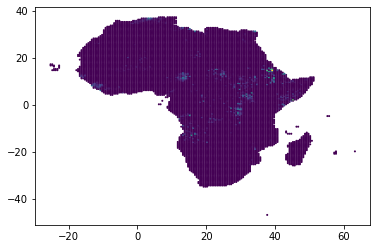

In [14]:
plt.scatter(X[:,0], X[:,1], c = y, s = 1)
plt.show()

# from script:

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
import time

from IPython.display import clear_output

from utils import get_views_coord
from utils import test_val_train
from utils import get_spatial_hps

import pymc3 as pm
import theano
import theano.tensor as tt

import warnings
warnings.simplefilter("ignore", UserWarning)

In [2]:
def get_spatial_gp(ℓ_alpha, ℓ_beta, η_beta, σ_beta):

    month_id = 384 # last month in train doing val - should not be that important here.
    nnz = 60 # should be better!
    with pm.Model() as model:

        # trend
        ℓ = pm.Gamma("ℓ", alpha=ℓ_alpha , beta=ℓ_beta)
        η = pm.HalfCauchy("η", beta=η_beta)
        cov = η **2 * pm.gp.cov.ExpQuad(2, ℓ) # Cov func.

        # noise model
        σ = pm.HalfCauchy("σ", beta=σ_beta)

        # mean func. (constant) 
        mean =  pm.gp.mean.Zero()

        # sample and split X,y ---------------------------------------------  
        non_zeroes = df.groupby('pg_id').sum().sort_values('ged_best_sb', ascending = False).index[:nnz]

        y = np.log(df[(df['id'].isin(train_id)) & (df['month_id'] == month_id)]['ged_best_sb'].values + 1)
        X = df[(df['id'].isin(train_id))  & (df['month_id'] == month_id)][['xcoord','ycoord']].values
        Xu = df[(df['id'].isin(train_id)) & (df['pg_id'].isin(non_zeroes)) & (df['month_id'] == month_id)][['xcoord','ycoord']].values

        # The GP
        gp = pm.gp.MarginalSparse(mean_func = mean ,cov_func=cov) #, approx="DTC") # ved ikke om det gør en forskel til FICT
        y_ = gp.marginal_likelihood("y", X=X, Xu = Xu, y=y, noise= σ)
    
    return(gp, X, y, σ)

In [3]:
# get df:
path = '/home/simon/Documents/Articles/conflict_prediction/data/ViEWS/'
file_name = 'ViEWS_coord.pkl'
df = get_views_coord(path = path, file_name = file_name)
print('got df')

# get trian/test id
train_id, val_id = test_val_train(df)
print('got split')

# get pkl mp
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/ViEWS/sce_mp_dict.pkl', 'rb')
mp_dict = pickle.load(pkl_file)
pkl_file.close()
print('got mp')

mp = mp_dict['mp']
mp_df = mp_dict['mp_df']

# geet hps and run gp
η_beta, ℓ_beta, ℓ_alpha, σ_beta = get_spatial_hps(plot = False)
gp, X, y, σ = get_spatial_gp(ℓ_alpha, ℓ_beta, η_beta, σ_beta)
print('ran gp - starts prediction')

# prediction
month_ids = df[df['id'].isin(train_id)]['month_id'].unique()
n = len(month_ids)

y = theano.shared(np.zeros(y.shape), 'y')
X = theano.shared(np.zeros(X.shape), 'X')

mu_list = []
var_list = []

for i, j in enumerate(month_ids):
    print(f'{i}/{n}')

    y.set_value( np.log(df[(df['id'].isin(train_id)) & (df['month_id'] == j)]['ged_best_sb'].values + 1))
    X.set_value(df[(df['id'].isin(train_id))  & (df['month_id'] == j)][['xcoord','ycoord']].values)

    mu, var = gp.predict(X, point=mp, given = {'gp' : gp, 'X' : X, 'y' : y, 'noise' : σ }, diag=True)
    mu_list.append(mu)
    var_list.append(var)
    
    clear_output(wait=True)

print('prediction done')

got df
Train from 1/1990 trough 12/2011 (264)
Val from 1/2012 trough 12/2014 (36)
Test time from 1/2015 trough 12/2017 (36)
(Test=False, so test set not outputted)

got split
got mp
ran gp - starts prediction
0/264
1/264
2/264
3/264
4/264
5/264
6/264
7/264
8/264
9/264
10/264
11/264
12/264
13/264
14/264
15/264
16/264
17/264
18/264
19/264
20/264
21/264
22/264
23/264


KeyboardInterrupt: 

In [ ]:
plt.scatter(X[:,0], X[:,1], c = mu, s = 1)
plt.show()

In [ ]:
η_beta, ℓ_beta, ℓ_alpha, σ_beta = get_spatial_hps(plot = False)
nnz = 60# 100% arpitrary
month_ids = df[df['id'].isin(train_id)]['month_id'].unique()
n = len(month_ids)

ℓ_list = []
η_list = []
σ_list = []

for i, j in enumerate(month_ids):
    

# DF: 

In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
import time

from IPython.display import clear_output


# check if/whar is still needed.
from utils import get_views_coord
from utils import test_val_train
from utils import get_spatial_hps

import pymc3 as pm
import theano
import theano.tensor as tt

import warnings
warnings.simplefilter("ignore", UserWarning)

In [12]:
# get pkl mp
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/ViEWS/sce_pred_df.pkl', 'rb')
sce_pred_df = pickle.load(pkl_file)
pkl_file.close()

In [13]:
sce_pred_df.sample(6)

,mu,var,month_id,xcoord,ycoord,log_best
27009,2.696265e-13,0.000477,123,30.75,10.25,0.0
42994,3.224370e-80,0.000477,125,22.75,-28.75,0.0
29776,6.057485e-09,0.000477,123,9.25,22.25,0.0
20578,-1.148904e-07,0.000378,122,8.25,29.75,0.0
16782,-1.165943e-22,0.000477,122,-5.75,12.25,0.0
15957,1.269740e-16,0.000477,122,39.75,8.75,0.0


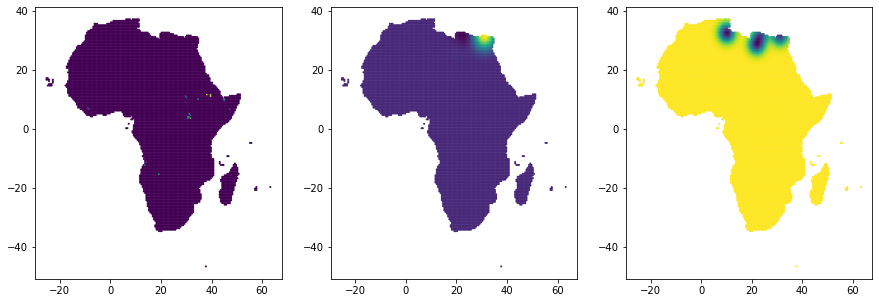

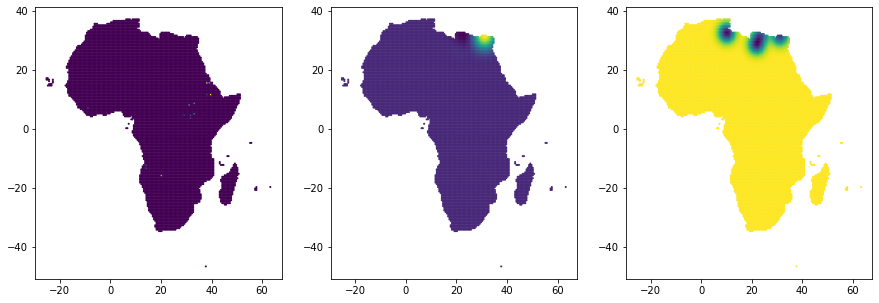

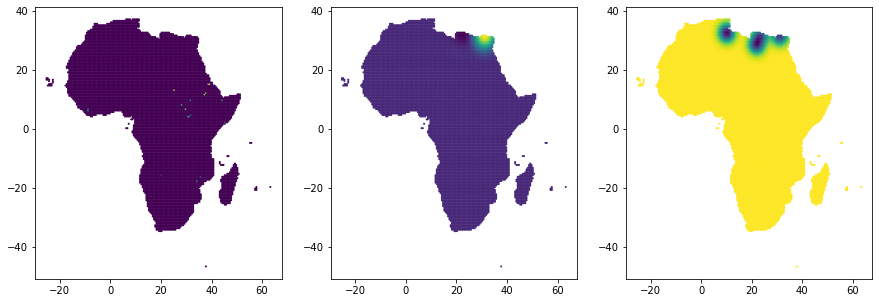

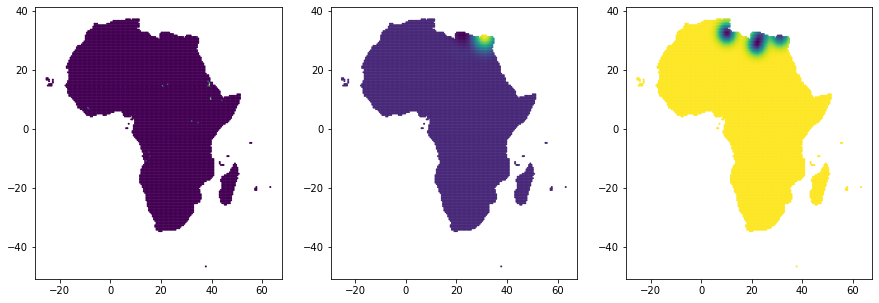

KeyboardInterrupt: 

In [14]:
month_ids = sce_pred_df['month_id'].unique()

for i, j in enumerate(month_ids):

    plt.figure(figsize=[15,5])
    plt.subplot(1,3,1)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['log_best'], s = 1)


    plt.subplot(1,3,2)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['mu'], s = 1)


    plt.subplot(1,3,3)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['var'], s = 1)


plt.show()

# Check get_cm_mp.py

In [15]:
# get pkl mp
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/computerome/currents/cm_mp_df.pkl', 'rb')
cm_mp_df = pickle.load(pkl_file)
pkl_file.close()

In [16]:
cm_mp_df

,Parameter,Value at MAP
0,ℓ_s,4.852810
1,η_s,0.339266
2,ℓ_l,112.953601
3,η_l,0.513069
4,σ,0.790460


# Check get_sce_mp.pym

In [9]:
import pandas as pd 
import numpy as np
import pickle
import pymc3 as pm
import matplotlib.pyplot as plt

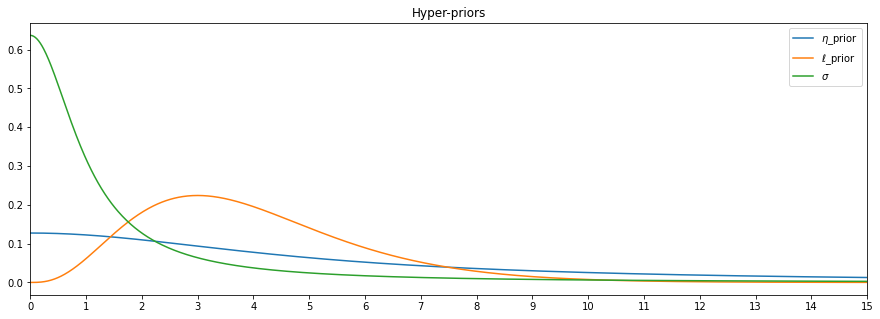

(5, 1, 4, 1)

In [19]:
def get_spatial_hps(plot = False):

    """Get the one trend spetial prior"""

    η_beta = 5
    ℓ_beta = 1
    ℓ_alpha = 4
    σ_beta = 1

    grid = np.linspace(0,15,1000)
    priors = [
        ('$\eta$_prior', pm.HalfCauchy.dist(beta=η_beta)),
        ('$\ell$_prior', pm.Gamma.dist(alpha=ℓ_alpha , beta=ℓ_beta )),
        ('$\sigma$', pm.HalfCauchy.dist(beta=σ_beta))]

    if plot == True:

        plt.figure(figsize= [15,5])
        plt.title('Hyper-priors')

        for i, prior in enumerate(priors):
            plt.plot(grid, np.exp(prior[1].logp(grid).eval()), label = prior[0])

        plt.xticks(np.arange(0,16,1))
        plt.xlim(0,15)
        plt.legend()
        plt.show()

    return(η_beta, ℓ_beta, ℓ_alpha, σ_beta)


get_spatial_hps(plot = True)

In [26]:
# get pkl mp
#pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/computerome/currents/cm_mp_df.pkl', 'rb')
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/ViEWS/sce_mp_df.pkl', 'rb')
mp = pickle.load(pkl_file)
pkl_file.close()

In [27]:
mp

{'ℓ_log__': array(2.0786513),
 'η_log__': array(-4.53399766),
 'σ_log__': array(-1.87641866),
 'ℓ': array(7.99368058),
 'η': array(0.01073766),
 'σ': array(0.15313756)}

In [28]:
# put it into a df for order - can always go back
sce_mp_df = pd.DataFrame({"Parameter": ["ℓ", "η", "σ"],
                       "Value at MAP": [float(mp["ℓ"]), float(mp["η"]), float(mp["σ"])]}) 

sce_mp_df

,Parameter,Value at MAP
0,ℓ,7.993681
1,η,0.010738
2,σ,0.153138


In [20]:
# get pkl mp
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/ViEWS/sce_mp_dict.pkl', 'rb')
#pkl_file = open('/home/projects/ku_00017/data/generated/currents/sce_mp_dict.pkl', 'rb')
mp_dict = pickle.load(pkl_file)
pkl_file.close()
print('got mp')

got mp


In [22]:
mp_dict['mp']

{'ℓ_log__': 1.1294805680618094,
 'η_log__': -3.8236950778817334,
 'σ_log__': -2.248833485393766,
 'ℓ': 3.0940489348154063,
 'η': 0.02184692547468923,
 'σ': 0.10552224603602453}

In [25]:
sce_mp_df[sce_mp_df['Parameter'] == 'ℓ'][]

,Parameter,Value at MAP
0,ℓ,7.99289


# sce pred:

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
import time

from utils import get_views_coord
from utils import test_val_train
from utils import get_spatial_hps
from utils import sample_conflict_timeline


import pymc3 as pm
import theano
import theano.tensor as tt

import warnings
warnings.simplefilter("ignore", UserWarning)

In [2]:
# Start timer
start_time = time.time()

# get df:
path = '/home/simon/Documents/Articles/conflict_prediction/data/ViEWS/'
#path = '/home/projects/ku_00017/data/generated/currents/'
file_name = 'ViEWS_coord.pkl'
df = get_views_coord(path = path, file_name = file_name)
print('got df')

# get trian/test id
train_id, val_id = test_val_train(df)
print('got split')

# get pkl mp
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/ViEWS/sce_mp.pkl', 'rb')
#pkl_file = open('/home/projects/ku_00017/data/generated/currents/sce_mp.pkl', 'rb')
sce_mp = pickle.load(pkl_file)
pkl_file.close()
print('got mp')

# get hps and run gp
η_beta, ℓ_beta, ℓ_alpha, σ_beta = get_spatial_hps(plot = False)


got df
Train from 1/1990 trough 12/2011 (264)
Val from 1/2012 trough 12/2014 (36)
Test time from 1/2015 trough 12/2017 (36)
(Test=False, so test set not outputted)

got split
got mp


In [3]:
# minimum number of conf in one year for timeslines to be used to est hyper parameters
C_est = 8

# conflict type.
conf_type = 'ged_best_sb'

print(f'{C_est}_{conf_type}')

# given new results it might actually be two trend...
with pm.Model() as model:

    # Hyper priors
    ℓ = pm.Gamma("ℓ", alpha=ℓ_alpha , beta=ℓ_beta)
    η = pm.HalfCauchy("η", beta=η_beta)
    cov = η **2 * pm.gp.cov.Matern32(2, ℓ) # Cov func.

    # noise model
    σ = pm.HalfCauchy("σ", beta=σ_beta)

    # mean func. (constant) 
    mean =  pm.gp.mean.Zero()

    # sample and split X,y ---------------------------------------------  
    sample_pr_id = sample_conflict_timeline(conf_type = conf_type, df = df, train_id = train_id, test_id = val_id, C = C_est)

    # GP
    gp = pm.gp.MarginalSparse(mean_func=mean ,cov_func=cov)
 
    # always prudent
    #df_sorted = df.sort_values(['pg_id', 'month_id'])

    #shared
    coord_len = df.groupby(['xcoord', 'ycoord']).sum().shape[0]
    y = theano.shared(np.zeros(coord_len), 'y')
    X = theano.shared(np.zeros([coord_len, 2]), 'X')

    # this does not vary here:
    Xu = theano.shared(df[(df['id'].isin(sample_pr_id))][['xcoord','ycoord']].values, 'Xu')

    # loop
    month_ids = df[df['id'].isin(train_id)]['month_id'].unique()[:5]
    n = month_ids.shape[0]

    for i, j in enumerate(month_ids):
        print(f'{i+1}/{n} (estimation)', end='\r')       

        y.set_value(np.log(df[(df['id'].isin(train_id)) & (df['month_id'] == j)]['ged_best_sb'].values + 1))
        X.set_value(df[(df['id'].isin(train_id))  & (df['month_id'] == j)][['xcoord','ycoord']].values)
        Xu.set_value(df[(df['pg_id'].isin(sample_pr_id)) & (df['month_id'] == j)][['xcoord','ycoord']].values) # could also just be all non-zeroes that month
 
        y_ = gp.marginal_likelihood(f"y_{i}", X=X, Xu = Xu, y=y, noise= σ)


8_ged_best_sb


In [6]:
# Containers
mu_list = []
var_list = []
month_list = []
y_list = []
X_list = []
xcoord_list = []
ycoord_list= []
log_best_list= []

for i, j in enumerate(month_ids):
    print(f'{i+1}/{n} (prediction)', end='\r')

    y.set_value(np.log(df[(df['id'].isin(train_id)) & (df['month_id'] == j)]['ged_best_sb'].values + 1))
    X.set_value(df[(df['id'].isin(train_id)) & (df['month_id'] == j)][['xcoord','ycoord']].values)

    mu, var = gp.predict(X, point=sce_mp, given = {'gp' : gp, 'X' : X, 'y' : y, 'noise' : σ }, diag=True)
    
    mu_list.append(mu)
    var_list.append(var)
    month_list.append([j] * mu.shape[0])
    xcoord_list.append(X.get_value()[:,0])
    ycoord_list.append(X.get_value()[:,1])
    log_best_list.append(y.get_value())

mu_col = np.array(mu_list).reshape(-1,)
var_col = np.array(var_list).reshape(-1,)
month_col = np.array(month_list).reshape(-1,)
xcoord_col = np.array(xcoord_list).reshape(-1,)
ycoord_col = np.array(ycoord_list).reshape(-1,)
log_best_col = np.array(log_best_list).reshape(-1,)


sce_pred_df = pd.DataFrame({'mu': mu_col, 'var':  var_col, 'month_id': month_col, 'xcoord': xcoord_col, 'ycoord': ycoord_col, 'log_best': log_best_col})

In [ ]:
month_ids = sce_pred_df['month_id'].unique()

for i, j in enumerate(month_ids):

    plt.figure(figsize=[15,5])
    plt.subplot(1,3,1)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['log_best'], s = 1)


    plt.subplot(1,3,2)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['mu'], s = 1)


    plt.subplot(1,3,3)
    plt.scatter(sce_pred_df[sce_pred_df['month_id'] == j]['xcoord'], 
                            sce_pred_df[sce_pred_df['month_id'] == j]['ycoord'], 
                            c = sce_pred_df[sce_pred_df['month_id'] == j]['var'], s = 1)


plt.show()

In [10]:
pkl_file = open('/home/simon/Documents/Articles/conflict_prediction/data/computerome/currents/sce_mp_df.pkl', 'rb')
sce_mp_df = pickle.load(pkl_file)
pkl_file.close()
print('got mp')
sce_mp_df

got mp


,Parameter,Value at MAP
0,ℓ,1.919228
1,η,0.021134
2,σ,0.120916


# OLD:

In [15]:
mu, var = gp.predict(X, point=mp, given = {'gp' : gp, 'X' : X, 'y' : y, 'noise' : σ}, diag = True)

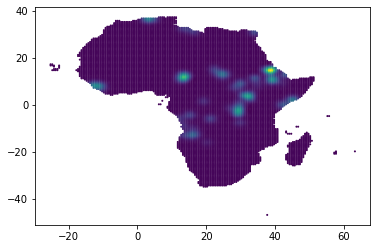

In [16]:
plt.scatter(X[:,0], X[:,1], c = mu, s = 1)
plt.show()

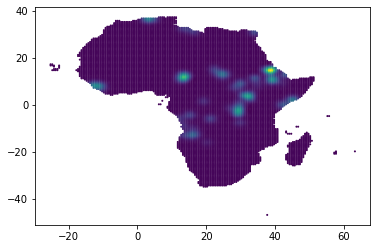

In [17]:
plt.scatter(X[:,0], X[:,1], c = mu, s = 1)
plt.show()

You don't have enough mem to try yearly or total here...

In [18]:
C_est = 100
nnz = 64

with pm.Model() as model:

    # trend
    ℓ = pm.Gamma("ℓ", alpha=ℓ_alpha , beta=ℓ_beta)
    η = pm.HalfCauchy("η", beta=η_beta)
    cov = η **2 * pm.gp.cov.ExpQuad(1, ℓ) # Cov func.

    # noise model
    σ = pm.HalfCauchy("σ", beta=σ_beta)

    # mean func. (constant) 
    mean =  pm.gp.mean.Zero()

    # gp = pm.gp.Marginal(mean_func = mean, cov_func=cov)
    gp = pm.gp.MarginalSparse(mean_func = mean, cov_func=cov)
    
    # sample and split X,y ---------------------------------------------  
    #sample_pr_id = sample_conflict_timeline(conf_type = conf_type, df = df, train_id = train_id, test_id = val_id, C = C_est)
    non_zeroes = df.groupby('pg_id').sum().sort_values('ged_best_sb', ascending = False).index[:nnz]

    y = np.log(df[df['id'].isin(train_id)]['ged_best_sb'].values + 1)
    X = df[df['id'].isin(train_id)][['xcoord','ycoord']].values
    Xu = df[(df['id'].isin(train_id)) & (df['pg_id'].isin(non_zeroes))][['xcoord','ycoord']].values

    y_ = gp.marginal_likelihood("y_", X=X, Xu = Xu, y=y, noise= σ)
    
    mp = pm.find_MAP()


MemoryError: Unable to allocate 355. GiB for an array with shape (16896, 2818728) and data type float64